# Flood Modeling Notebook

from : `src/001_simulation.ipynb`

In [1]:
!which python

/opt/conda/bin/python


## Torch x CUDA x GPU

In [2]:
import torch
print(torch.__version__)
torch.cuda.is_available()

2.0.1


True

## Import 

In [3]:
import os, glob, random, time, gc
from tqdm.notebook import tqdm

import tifffile
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp

torch.manual_seed(1234)
np.random.seed(1234)
random.seed(1234)
torch.backends.cudnn.benchmark = False
torch.backends.cudnn.deterministic = True

os.makedirs('../output/modeling', exist_ok=True)

In [4]:
flood_depth = 11.0

## Visualize

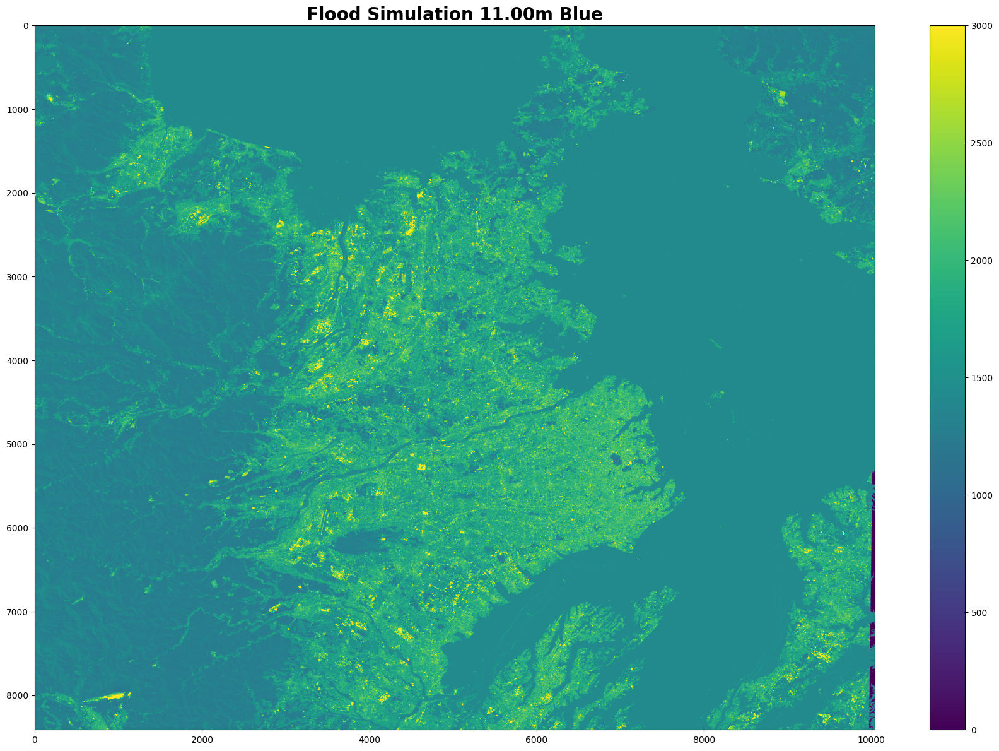

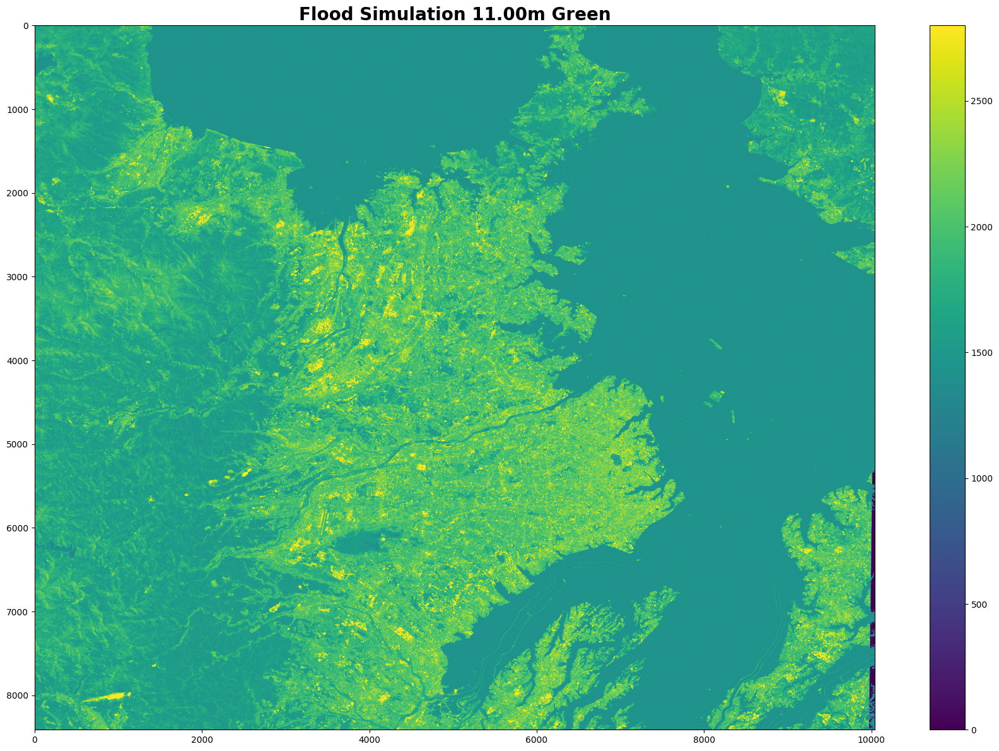

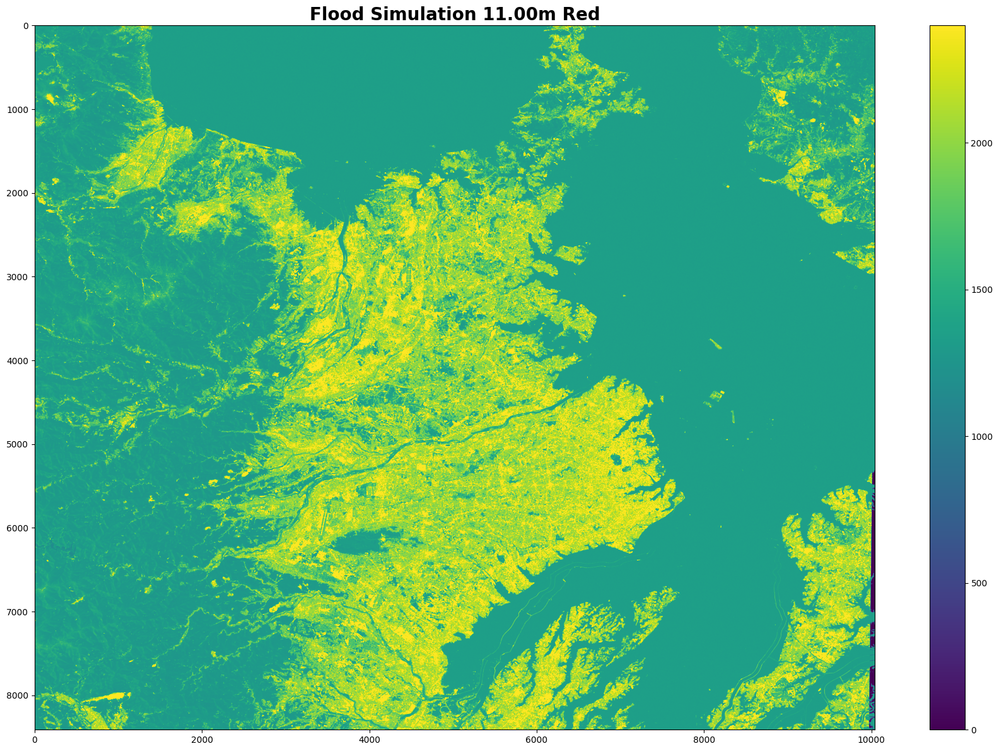

In [5]:
PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
img = tifffile.imread(PATH).astype(np.float32)

plt.figure(figsize=(18, 12))
plt.title(f'Flood Simulation {flood_depth:.2f}m Blue', fontsize=20, fontweight='bold')
plt.imshow(img[: ,:, 0], vmax=3000)
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/flood_{flood_depth:.2f}_blue.png')
plt.show();
plt.clf()
plt.close()

plt.figure(figsize=(18, 12))
plt.title(f'Flood Simulation {flood_depth:.2f}m Green', fontsize=20, fontweight='bold')
plt.imshow(img[: ,:, 1], vmax=2800)
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/flood_{flood_depth:.2f}_green.png')
plt.show();
plt.clf()
plt.close()

plt.figure(figsize=(18, 12))
plt.title(f'Flood Simulation {flood_depth:.2f}m Red', fontsize=20, fontweight='bold')
plt.imshow(img[: ,:, 2], vmax=2400)
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/flood_{flood_depth:.2f}_red.png')
plt.show();
plt.clf()
plt.close()

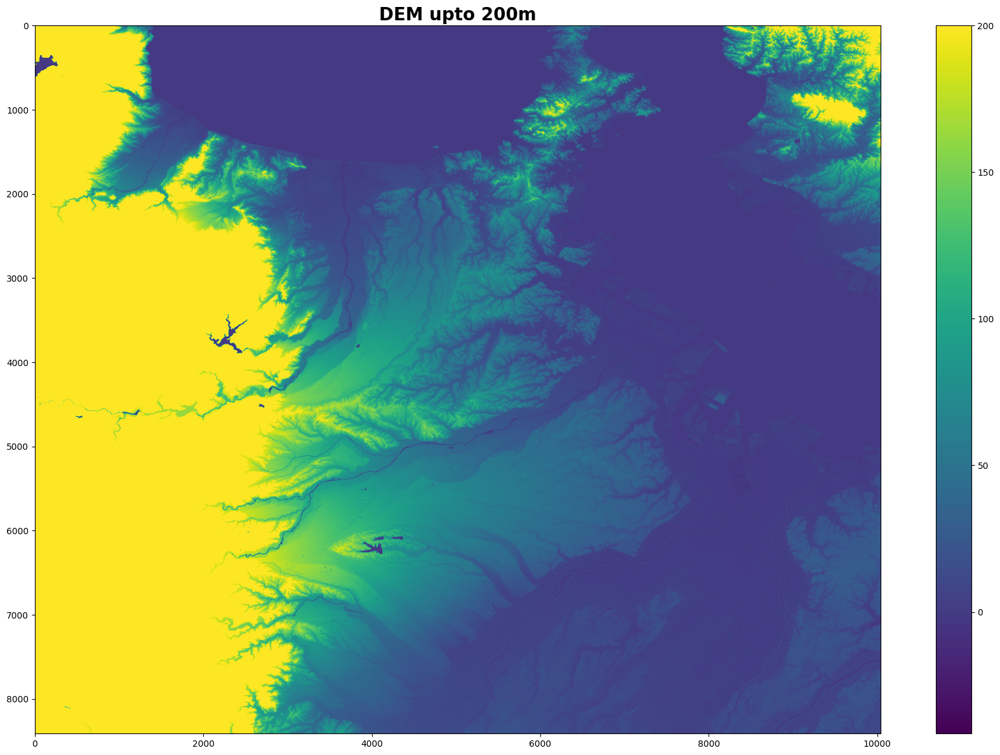

In [6]:
PATH = f'../output/dem_resize_gt.tif'
gt = tifffile.imread(PATH).astype(np.float32)

plt.figure(figsize=(18, 12))
plt.title('DEM upto 200m', fontsize=20, fontweight='bold')
plt.imshow(gt, vmax=200)
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/dem_gt.png')
plt.show();
plt.clf()
plt.close()

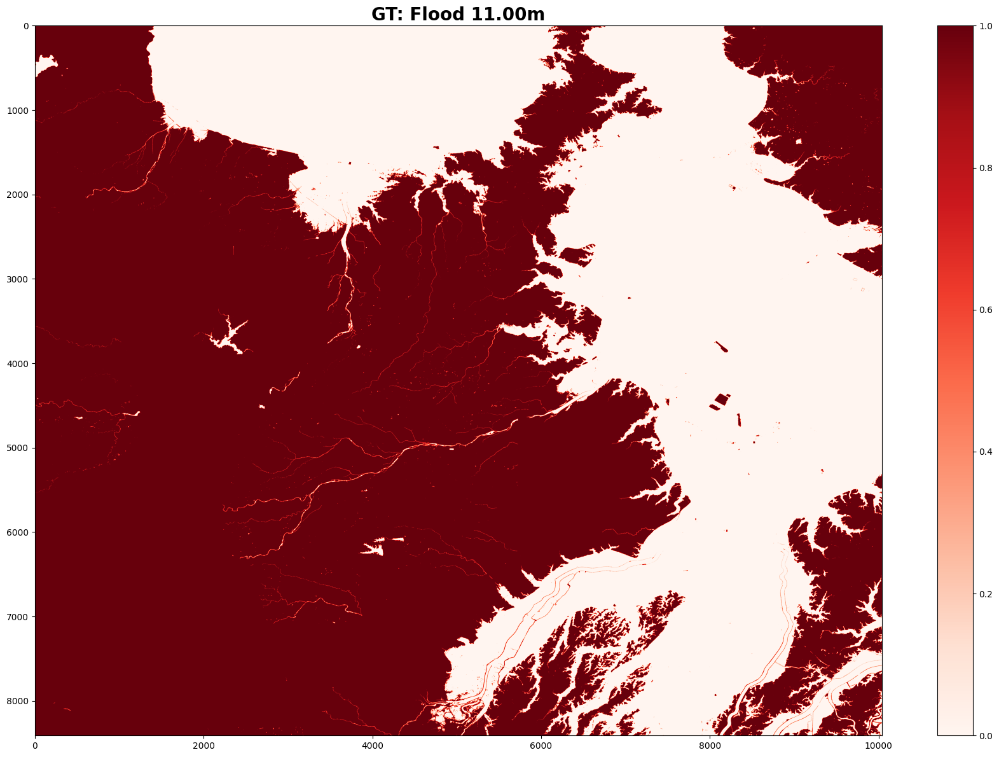

In [7]:
plt.figure(figsize=(18, 12))
plt.title('GT: Flood 11.00m', fontsize=20, fontweight='bold')
plt.imshow((gt > flood_depth).astype(np.float32), cmap='Reds')
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/gt_{flood_depth:.2f}.png')
plt.show();
plt.clf()
plt.close()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


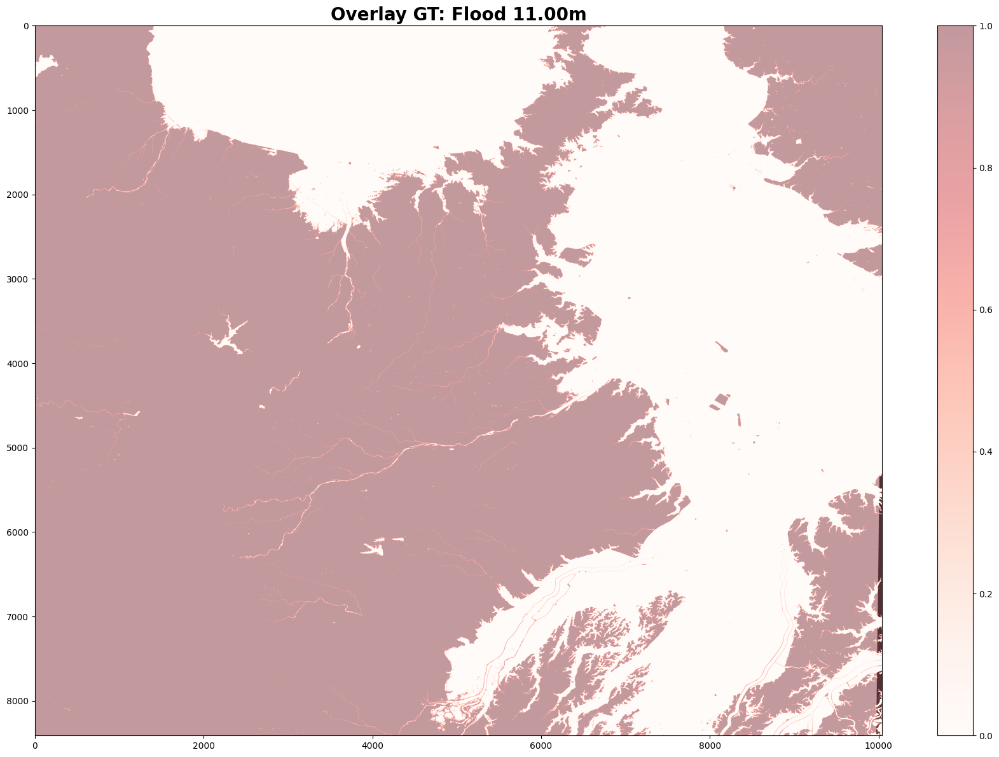

In [8]:
plt.figure(figsize=(18, 12))
plt.title('Overlay GT: Flood 11.00m', fontsize=20, fontweight='bold')
plt.imshow(img, vmax=3000, cmap='gray', alpha=0.7)
plt.imshow((gt > flood_depth).astype(np.float32), alpha=0.4, cmap='Reds')
plt.colorbar()
plt.tight_layout()
plt.savefig(f'../output/overlay_gt_{flood_depth:.2f}.png')
plt.show();
plt.clf()
plt.close()

## Split

In [9]:
step = 1
depthes = np.arange(0., 40., step=step)
depthes

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38.,
       39.])

In [11]:
IMG_SIZE = 256

patch_depths, patch_hs, patch_ws, patch_paths = [], [], [], []

for depth in tqdm(depthes):
    PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
    img = tifffile.imread(PATH).astype(np.float32)

    features = [img[:, :, 0], img[:, :, 1], img[:, :, 2], (gt < depth).astype(np.float32)]
    imgs = np.stack(features, axis=2) # Hight, Width, Channel:2

    for h in range(img.shape[0] // IMG_SIZE):
        for w in range(img.shape[1]  // IMG_SIZE):
          patch = imgs[h*IMG_SIZE:(h+1)*IMG_SIZE, w*IMG_SIZE:(w+1)*IMG_SIZE]

          PATH_PATCH = f'../output/modeling/z_depth{depth:.2f}_patch_h{str(h).zfill(3)}_w{str(w).zfill(3)}.npy'
          np.save(PATH_PATCH, patch)
          
          patch_depths.append(depth)
          patch_hs.append(h)
          patch_ws.append(w)
          patch_paths.append(PATH_PATCH)

    del imgs, img
    gc.collect()

  0%|          | 0/40 [00:00<?, ?it/s]

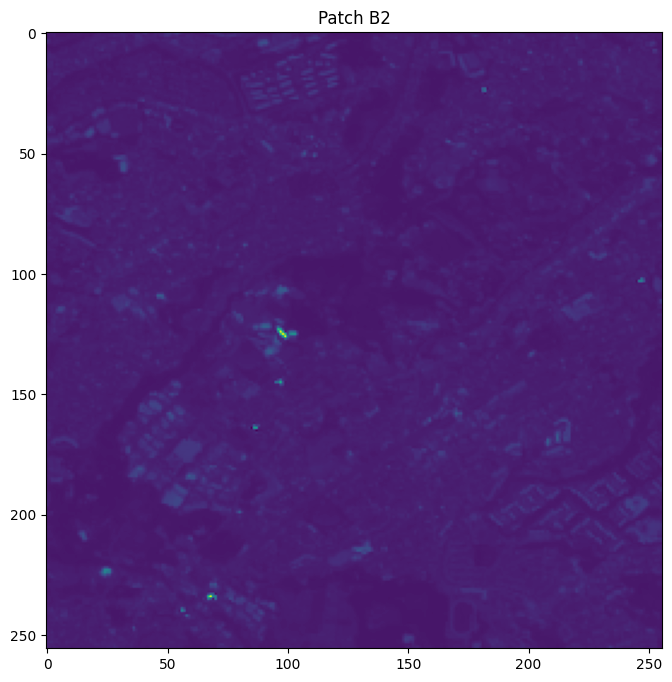

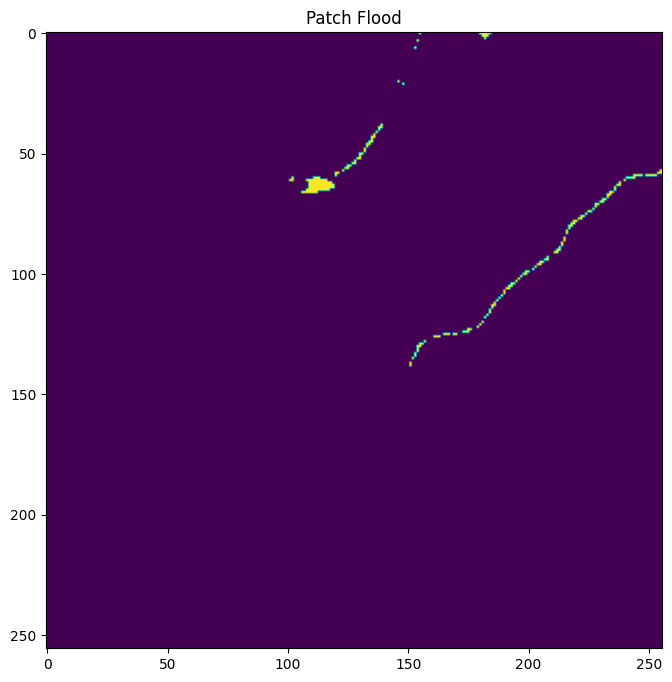

In [12]:

PATH_PATCH = '../output/modeling/z_depth11.00_patch_h017_w018.npy'
patch = np.load(PATH_PATCH)

plt.figure(figsize=(8, 8))
plt.title('Patch B2')
plt.imshow(patch[:, :, 0])
plt.savefig('../output/patch_b2.png')
plt.show();

plt.figure(figsize=(8, 8))
plt.title('Patch Flood')
plt.imshow(patch[:, :, -1])
plt.savefig('../output/patch_flood.png')
plt.show();

plt.clf()
plt.close()

## Dataset

In [13]:
class DataTransform():
    def __init__(self):
        self.data_transform = {
            "train": A.Compose(
                [
                  A.HorizontalFlip(p=0.5),
                  A.VerticalFlip(p=0.5),
                  A.Transpose(p=0.5),
                  # A.Cutout(p=0.25),
                  ToTensorV2()
                ]
            ),
            "val": A.Compose(
                [
                  ToTensorV2(),
                ]
            )
        }

    def __call__(self, phase, img, anno_class_img):
        return self.data_transform[phase](image=img, mask=anno_class_img)

class FloodDataset(Dataset):
    def __init__(self, img_list, phase, transform):
        self.img_list = img_list
        self.phase = phase
        self.transform = transform

    def __len__(self):
        return len(self.img_list)

    def __getitem__(self, index):
        return self.pull_item(index)

    def pull_item(self, index):
        image_file_path = self.img_list[index]
        features = np.load(image_file_path)
        img, anno = features[:,:,:3], features[:,:,-1]
        
        img_and_anno = self.transform(self.phase, img, anno)
        img = img_and_anno["image"]
        anno = img_and_anno["mask"]

        return img, anno

In [ ]:
# df = pd.read_csv('../output/patch_list.csv')

In [14]:
df = pd.DataFrame({
    'depth': patch_depths,
    'h': patch_hs,
    'w': patch_ws,
    'path': patch_paths
})
df.head()

,depth,h,w,path
0,0.0,0,0,../output/modeling/z_depth0.00_patch_h000_w000...
1,0.0,0,1,../output/modeling/z_depth0.00_patch_h000_w001...
2,0.0,0,2,../output/modeling/z_depth0.00_patch_h000_w002...
3,0.0,0,3,../output/modeling/z_depth0.00_patch_h000_w003...
4,0.0,0,4,../output/modeling/z_depth0.00_patch_h000_w004...


In [15]:
df.to_csv('../output/patch_list.csv', index=False)

In [16]:
df.h.unique().max(), df.w.unique().max()

(31, 38)

## Cross Validation

In [87]:
IDX_SPLIT, BATCH_SIZE = 26, 32
PATHS_TRAIN = df[df['h'] < IDX_SPLIT]['path'].values
PATHS_VALID = df[df['h'] >= IDX_SPLIT]['path'].values
print(PATHS_TRAIN.shape, PATHS_VALID.shape)

train_dataset = FloodDataset(PATHS_TRAIN, phase="train", transform=DataTransform())
val_dataset = FloodDataset(PATHS_VALID, phase="val", transform=DataTransform())

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

dataloaders_dict = {"train": train_dataloader, "valid": val_dataloader}

(40560,) (9360,)


## Model

In [ ]:
model = smp.Unet(
    encoder_name='timm-efficientnet-b0',
    encoder_weights='imagenet',
    in_channels=3, # RGB
    classes=1,
    activation=None,
)

loss_fn = torch.nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW([dict(params=model.parameters(), lr=1e-4), ])

Downloading: "https://github.com/huggingface/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b0-0af12548.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_b0-0af12548.pth
100%|██████████| 20.4M/20.4M [00:00<00:00, 25.0MB/s]


## Train

In [89]:
EPOCHS = 10
best_score = 1E6

train_loss = []
valid_loss = []

model = model.cuda()

for i in tqdm(range(0, EPOCHS)):
  loss_epoch = []

  for phase in ['train', 'valid']:
    print(f'Epoch: {i} Phase {phase}')
    for (img, anno) in tqdm(dataloaders_dict[phase]):
      img, anno = img.cuda(), anno.cuda()

      if phase == 'train':
        model.train()
        output = model(img)
        loss = loss_fn(output.squeeze(dim=1), anno.squeeze(dim=1))
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        loss = loss.cpu().detach().numpy()
        
      else:
        with torch.no_grad():
          model.eval()
          output = model(img)
          loss = loss_fn(output.squeeze(dim=1), anno.squeeze(dim=1))
          loss = loss.cpu().numpy()

      loss_epoch.append(loss)

    if phase == 'train':
      train_loss.append(np.array(loss_epoch).mean())
    else:
      loss_mean = np.array(loss_epoch).mean()
      valid_loss.append(loss_mean)
      
      torch.save(model, os.path.join("../output/weights/", f'model_epoch{i}.pth'))
      
      if best_score > loss_mean:
          best_score = loss_mean
          
          torch.save(model, os.path.join("../output/weights/", 'best_model.pth'))
          print('Model saved')

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 0 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 0 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 1 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 1 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 2 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 2 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 3 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 3 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 4 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 4 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 5 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 5 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Epoch: 6 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 6 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 7 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 7 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Epoch: 8 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 8 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

Model saved
Epoch: 9 Phase train


  0%|          | 0/1268 [00:00<?, ?it/s]

Epoch: 9 Phase valid


  0%|          | 0/293 [00:00<?, ?it/s]

## Metrics

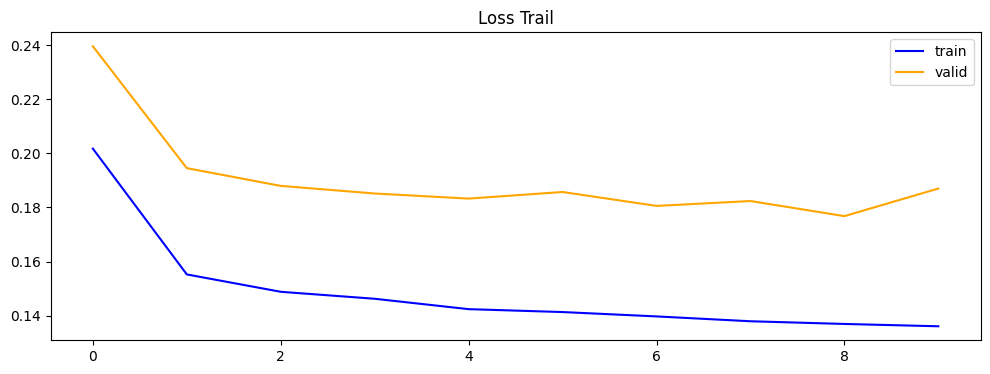

In [90]:
plt.figure(figsize=(12, 4))
plt.title('Loss Trail')
plt.plot(np.array(train_loss), label='train', color='blue')
plt.plot(np.array(valid_loss), label='valid', color='orange')
plt.legend()
plt.savefig('../output/loss.png')
plt.show();
plt.clf()
plt.close()

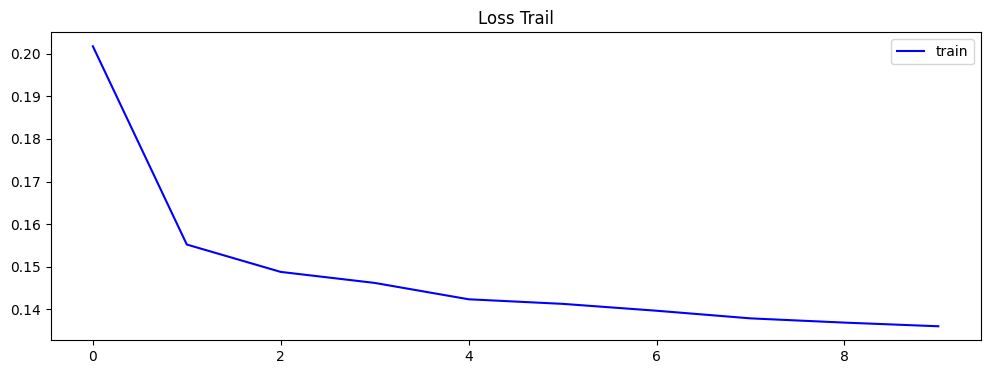

In [91]:
plt.figure(figsize=(12, 4))
plt.title('Loss Trail')
plt.plot(np.array(train_loss), label='train', color='blue')
plt.legend()
plt.savefig('../output/loss_train.png')
plt.show();
plt.clf()
plt.close()

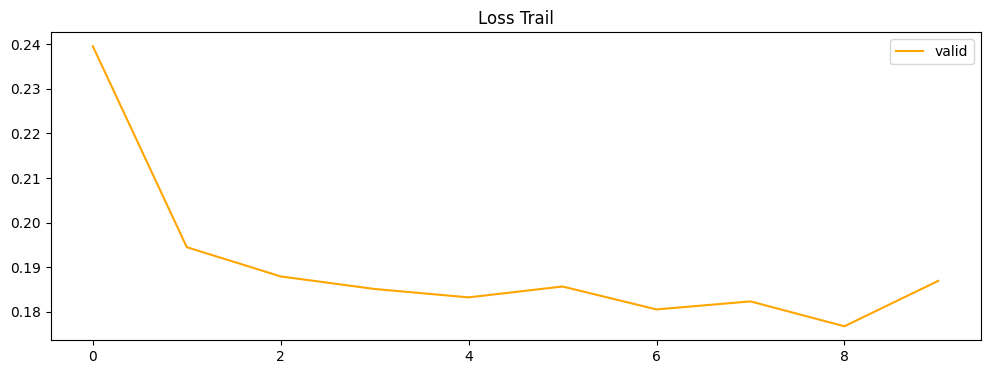

In [92]:
plt.figure(figsize=(12, 4))
plt.title('Loss Trail')
plt.plot(np.array(valid_loss), label='valid', color='orange')
plt.legend()
plt.savefig('../output/loss_val.png')
plt.show();
plt.clf()
plt.close()

## Inference

In [24]:
depth, th = 11.0, 0.5

PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
img = tifffile.imread(PATH).astype(np.float32)

preprocesser = A.Compose([ToTensorV2(),])
model.eval()

features = [img[:, :, 0], img[:, :, 1], img[:, :, 2], (gt < depth).astype(np.float32)]
imgs = np.stack(features, axis=2) # Hight, Width, Channel:2

prediction = np.zeros((img.shape[0], img.shape[1]), dtype=np.float32) - 1

with torch.no_grad():
  for h in tqdm(range(img.shape[0] // IMG_SIZE)):
    for w in range(img.shape[1]  // IMG_SIZE):
      patch = imgs[h*IMG_SIZE:(h+1)*IMG_SIZE, w*IMG_SIZE:(w+1)*IMG_SIZE]
      im = preprocesser(image=patch[:,:, :3])['image']
      im = im.unsqueeze(dim=0).cuda()
      output = model(im)[0]
      pred = torch.sigmoid(output).cpu().numpy()
      # pred = (pred > th).astype(np.float32)
      
      prediction[h*IMG_SIZE:(h+1)*IMG_SIZE, w*IMG_SIZE:(w+1)*IMG_SIZE] = pred

  0%|          | 0/32 [00:00<?, ?it/s]

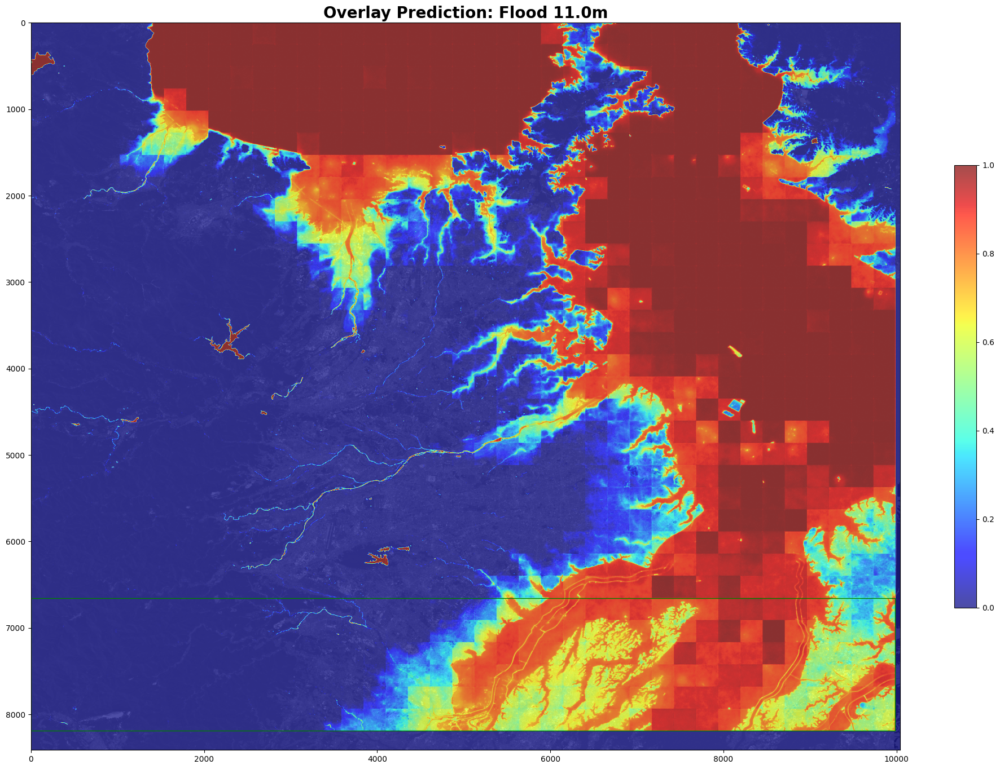

In [93]:
PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
img = tifffile.imread(PATH).astype(np.float32)

plt.figure(figsize=(20, 16))

ax = plt.axes()
ax.set_title(f'Overlay Prediction: Flood {depth}m', fontsize=20, fontweight='bold')
plt.imshow(img[:, :, 0], vmax=3000, cmap='gray', alpha=0.7)
plt.imshow(prediction, alpha=0.7, cmap='jet', vmin=0, vmax=1)

bbox = ((IMG_SIZE * 0 + 1, IMG_SIZE * IDX_SPLIT + 1), (IMG_SIZE * (df.w.unique().max() + 1) - 1, IMG_SIZE * (df.h.unique().max() + 1) - 1))

p = patches.Rectangle(xy=(
    bbox[0][0], bbox[0][1]
    ), 
        width=bbox[1][0] - bbox[0][0], 
        height=bbox[1][1] - bbox[0][1]
        , color='green', fill=False)
ax.add_patch(p)

plt.colorbar(shrink=0.5)
plt.tight_layout()
plt.savefig(f'../output/overlay_prediction_{flood_depth:.2f}.png')
plt.show();
plt.clf()
plt.close()

tifffile.imwrite(f'../output/prediction.tif', prediction)

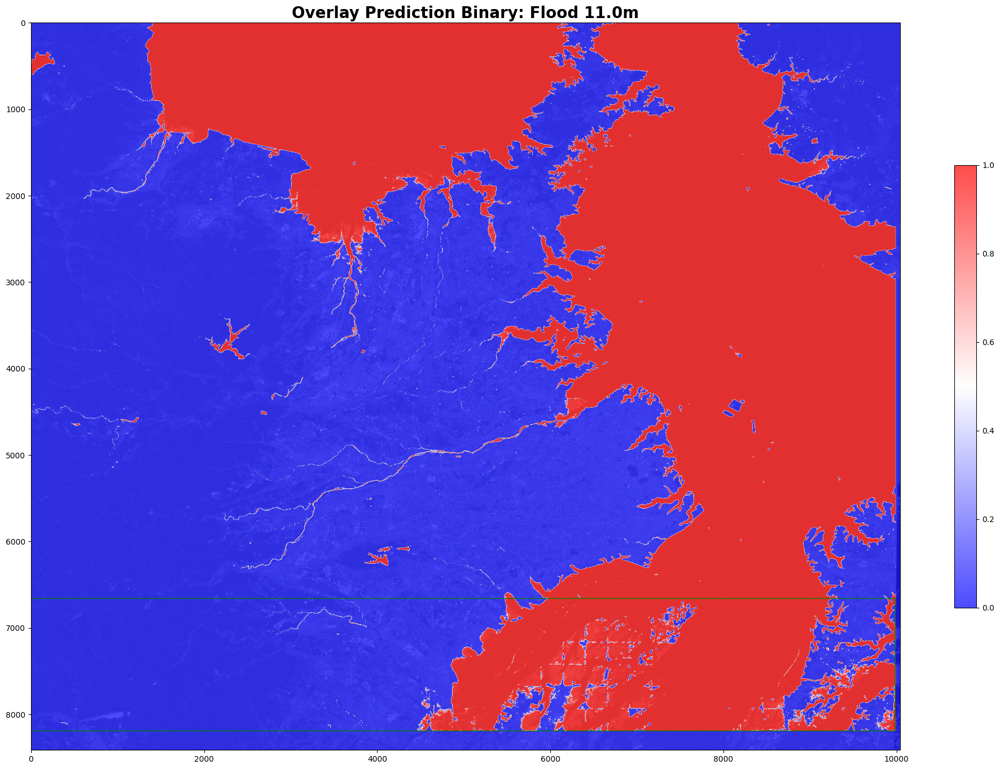

In [94]:
TH = 0.6

prediction_bin = (prediction > TH).astype(np.float32)

PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
img = tifffile.imread(PATH).astype(np.float32)

plt.figure(figsize=(20, 16))

ax = plt.axes()
ax.set_title(f'Overlay Prediction Binary: Flood {depth}m', fontsize=20, fontweight='bold')
plt.imshow(img[:, :, 0], vmax=3000, cmap='gray', alpha=0.7)
plt.imshow(prediction_bin, alpha=0.7, cmap='bwr', vmin=0, vmax=1)

bbox = ((IMG_SIZE * 0 + 1, IMG_SIZE * IDX_SPLIT + 1), (IMG_SIZE * (df.w.unique().max() + 1) - 1, IMG_SIZE * (df.h.unique().max() + 1) - 1))

p = patches.Rectangle(xy=(
    bbox[0][0], bbox[0][1]
    ), 
        width=bbox[1][0] - bbox[0][0], 
        height=bbox[1][1] - bbox[0][1]
        , color='green', fill=False)
ax.add_patch(p)

plt.colorbar(shrink=0.5)
plt.tight_layout()
plt.savefig(f'../output/overlay_prediction_{flood_depth:.2f}_bin.png')
plt.show();
plt.clf()
plt.close()

tifffile.imwrite(f'../output/prediction_bin.tif', prediction_bin)

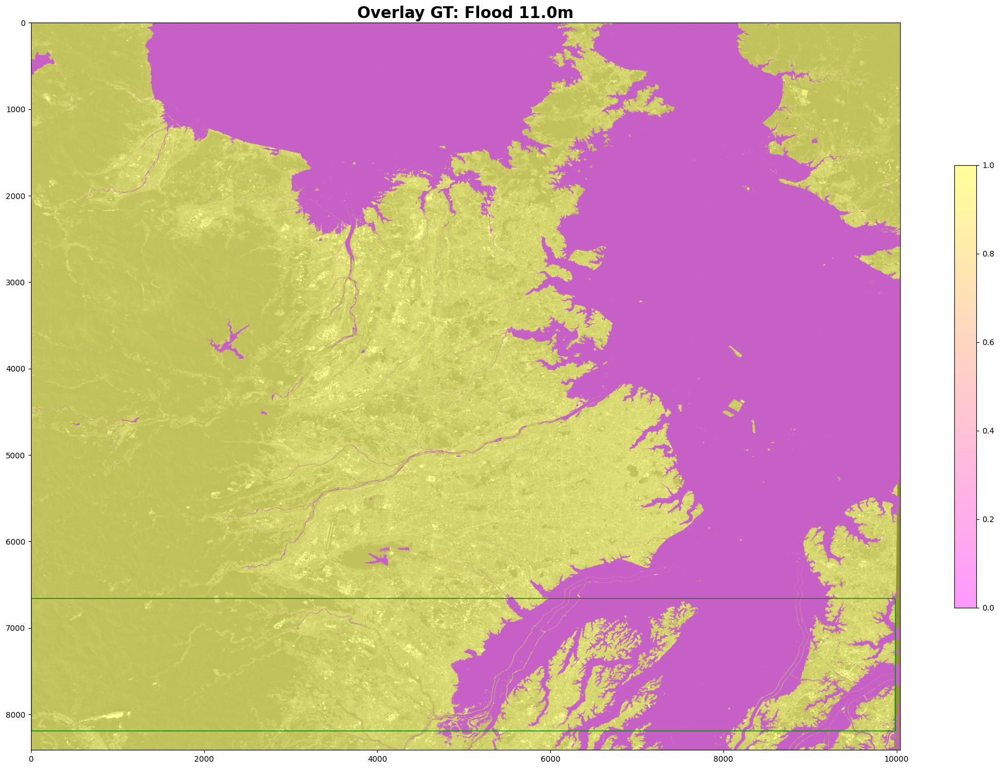

In [54]:

PATH = f'../output/virtual_flood/flood_{flood_depth:.2f}.tif'
img = tifffile.imread(PATH).astype(np.float32)

PATH = f'../output/dem_resize_gt.tif'
gt = tifffile.imread(PATH).astype(np.float32)
gt_bin = np.where(gt >  flood_depth, 1, 0)

plt.figure(figsize=(20, 16))

ax = plt.axes()
ax.set_title(f'Overlay GT: Flood {depth}m', fontsize=20, fontweight='bold')
plt.imshow(img[:, :, 0], vmax=3000, cmap='gray', alpha=0.7)
plt.imshow(gt_bin, alpha=0.4, cmap='spring', vmin=0, vmax=1)

bbox = ((IMG_SIZE * 0 + 1, IMG_SIZE * IDX_SPLIT + 1), (IMG_SIZE * (df.w.unique().max() + 1) - 1, IMG_SIZE * (df.h.unique().max() + 1) - 1))

p = patches.Rectangle(xy=(
    bbox[0][0], bbox[0][1]
    ), 
        width=bbox[1][0] - bbox[0][0], 
        height=bbox[1][1] - bbox[0][1]
        , color='green', fill=False)
ax.add_patch(p)

plt.colorbar(shrink=0.5)
plt.tight_layout()
plt.savefig(f'../output/overlay_gt_{flood_depth:.2f}_bin.png')
plt.show();
plt.clf()
plt.close()

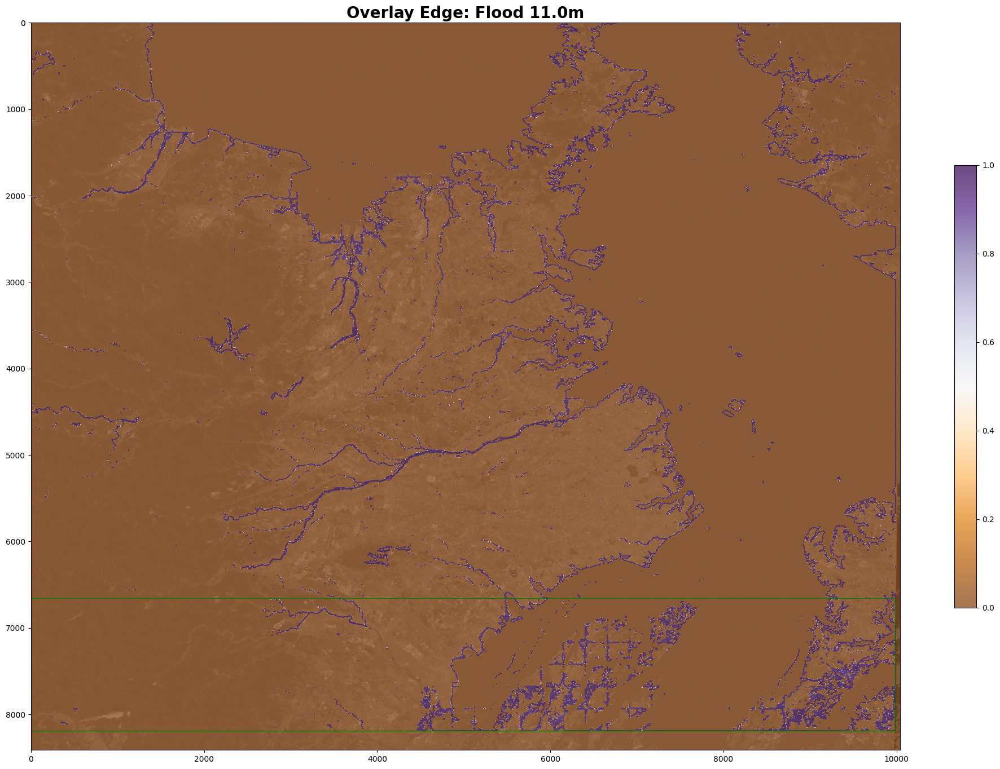

In [95]:
prediction_bin_canny = cv2.Canny((prediction_bin * 255).astype(np.uint8), 10, 250)

plt.figure(figsize=(20, 16))

ax = plt.axes()
ax.set_title(f'Overlay Edge: Flood {depth}m', fontsize=20, fontweight='bold')
plt.imshow(img[:, :, 0], vmax=3000, cmap='gray', alpha=0.7)
plt.imshow(prediction_bin_canny, alpha=0.7, cmap='PuOr', vmin=0, vmax=1)

bbox = ((IMG_SIZE * 0 + 1, IMG_SIZE * IDX_SPLIT + 1), (IMG_SIZE * (df.w.unique().max() + 1) - 1, IMG_SIZE * (df.h.unique().max() + 1) - 1))

p = patches.Rectangle(xy=(
    bbox[0][0], bbox[0][1]
    ), 
        width=bbox[1][0] - bbox[0][0], 
        height=bbox[1][1] - bbox[0][1]
        , color='green', fill=False)
ax.add_patch(p)

plt.colorbar(shrink=0.5)
plt.tight_layout()
plt.savefig(f'../output/overlay_edge_{flood_depth:.2f}_bin.png')
plt.show();
plt.clf()
plt.close()

tifffile.imwrite(f'../output/prediction_edge.tif', prediction_bin_canny)

14.311615 21.091574


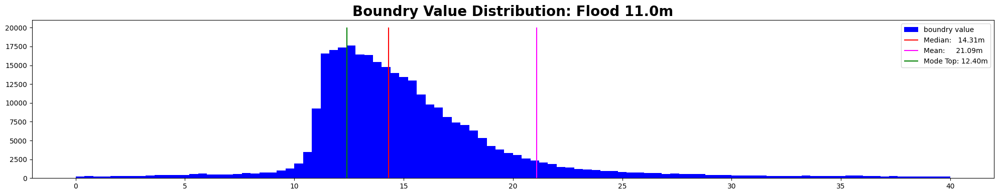

In [86]:
boundry_points_dem = gt[prediction_bin_canny > 0.5]

boundry_median, boundry_mean = np.median(boundry_points_dem), np.mean(boundry_points_dem)
print(boundry_median, boundry_mean)

plt.figure(figsize=(20, 4))
plt.title(f'Boundry Value Distribution: Flood {depth}m', fontsize=20, fontweight='bold')
n, bins, patchs = plt.hist(boundry_points_dem, bins=100, color='blue', label='boundry value', range=(0, 40))

mode_top = np.argmax(n)
boundry = bins[mode_top]

plt.vlines(boundry_median, 0, 20000, color='red',   label=f'Median:   {boundry_median:.2f}m')
plt.vlines(boundry_mean, 0, 20000, color='magenta', label=f'Mean:     {boundry_mean:.2f}m')
plt.vlines(boundry, 0, 20000, color='green',        label=f'Mode Top: {boundry:.2f}m')

plt.legend()
plt.savefig(f'../output/overlay_edge_{flood_depth:.2f}_bin_hist.png')
plt.tight_layout()
plt.show();
plt.clf()
plt.close()